<class 'pandas.core.frame.DataFrame'>
RangeIndex: 288 entries, 0 to 287
Data columns (total 6 columns):
宝贝ID    288 non-null int64
标题      288 non-null object
价格      288 non-null float64
玩具类型    252 non-null object
适用年龄    284 non-null object
品牌      288 non-null object
dtypes: float64(1), int64(1), object(4)
memory usage: 13.6+ KB
None
           宝贝ID                                标题    价格  玩具类型  \
0  537396783238    创意新款回力小车惯性坦克 军事儿童玩具模型地摊货源玩具车批发  8.90  塑胶玩具   
1   36286235128  2017热卖大号仿真惯性挖土机儿童益智礼品创意义乌地摊货玩具批发  3.90  其它玩具   
2   35722000205    创意发光球闪光透明发光水晶弹力球儿童小玩具 夜市地摊货源批发  1.65  其它玩具   
3  550659732532    新款创意六一儿童节礼物音乐投影电动枪夜市地摊货源批发男孩玩具  9.90  其它玩具   
4  531877266868   发条玩具批发上链卡通动物青蛙儿童礼物宝宝玩具经典80后益智地摊  1.85  其它玩具   

                                       适用年龄          品牌  
0                               3岁,4岁,5岁,6岁  qianjie/千杰  
1                               3岁,4岁,5岁,6岁  qianjie/千杰  
2          3岁,4岁,5岁,6岁,7岁,8岁,9岁,10岁,11岁,12岁  qianjie/千杰  
3  3岁,4岁,5岁,6岁,7岁,8岁,9岁,10岁,11岁,12岁,1

D:\Anaconda3\lib\site-packages\pandas\tools\merge.py:536: UserWarning: merging between different levels can give an unintended result (1 levels on the left, 2 on the right)
  warnings.warn(msg, UserWarning)


<class 'pandas.core.frame.DataFrame'>
Index: 3332 entries, 00075234ckx to 龚泽伟4321
Data columns (total 15 columns):
收货地址               3332 non-null object
买家应付货款             3332 non-null float64
宝贝种类               3332 non-null float64
宝贝总数量              3332 non-null float64
(购买数量, missing)    3332 non-null float64
(购买数量, 中大童)        3332 non-null float64
(购买数量, 全年龄段)       3332 non-null float64
(购买数量, 婴儿)         3332 non-null float64
(购买数量, 婴小中童)       3332 non-null float64
(购买数量, 婴小童)        3332 non-null float64
(购买数量, 小中大童)       3332 non-null float64
(购买数量, 小中童)        3332 non-null float64
(购买数量, 小童)         3332 non-null float64
购买次数               3332 non-null int64
类别                 3332 non-null int32
dtypes: float64(12), int32(1), int64(1), object(1)
memory usage: 403.5+ KB
None
             收货地址  买家应付货款  宝贝种类  宝贝总数量  (购买数量, missing)  (购买数量, 中大童)  \
买家会员名                                                                  
00075234ckx   福建省    9.90   1.0    1.0             

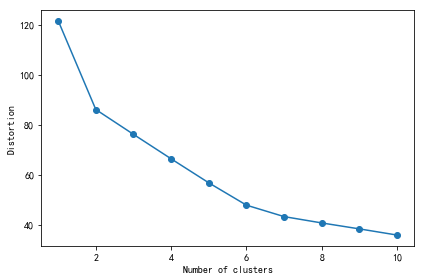

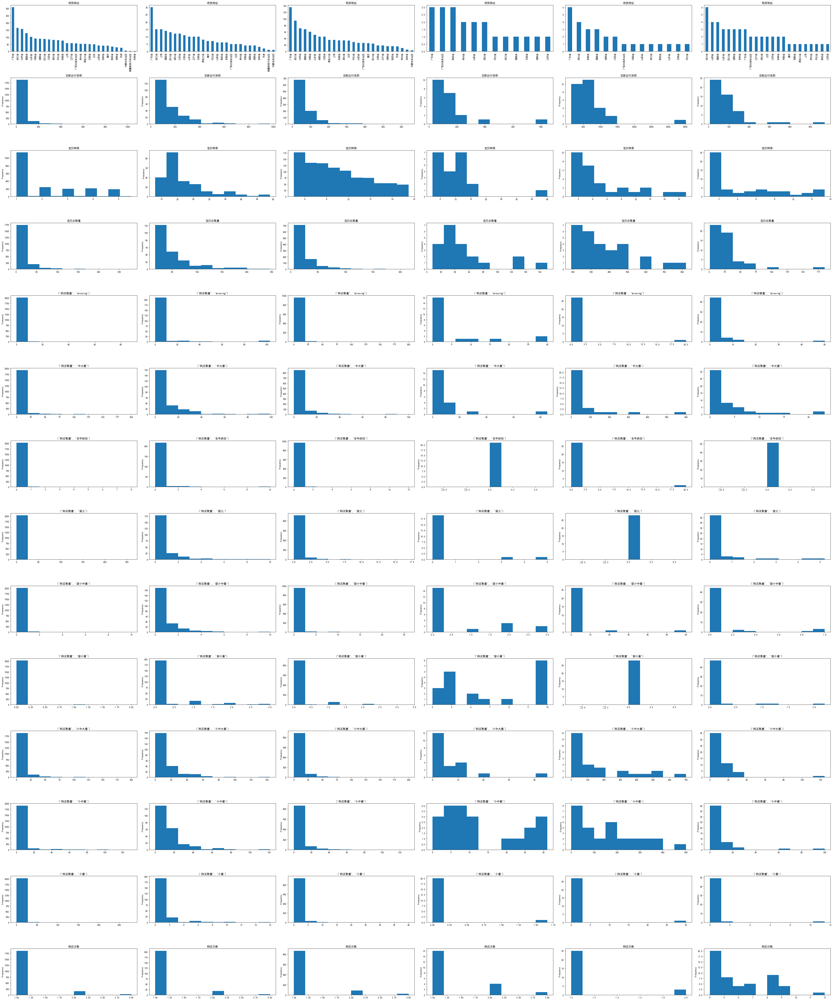

In [1]:
###########################################################
#                 淘宝玩具店买家KMeans聚类                #
###########################################################

%matplotlib inline
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler

def viewInfo(df):
    print (df.info())
    print (df.head())

def addTag(x):
    tag = ""
    if "月" in x:
        tag+="婴儿,"
    if ("3岁" in x or "4岁" in x) and "13岁" not in x:
        tag+="小童,"
    if "5岁" in x or "6岁" in x or "7岁" in x or "8岁" in x:
        tag+="中童,"
    if "9岁" in x or "10岁" in x or "11岁" in x or "12岁" in x:
        tag+="大童,"
    if "missing" in x:
        tag+="missing"
    return tag

df = pd.read_csv("D:/itemProps.csv")
viewInfo(df)
print (df["适用年龄"].value_counts())
df["适用年龄"]=df["适用年龄"].fillna("missing")
print (df["适用年龄"].value_counts())

df["tags"]=""
df.tags=df.适用年龄.apply(addTag)
print (df.tags.value_counts())

mapDict = {"小童,中童,":"小中童","小童,中童,大童,":"小中大童","中童,大童,":"中大童","婴儿,":"婴儿","婴儿,小童,中童,":"婴小中童",
           "小童,":"小童","missing":"missing","婴儿,小童,":"婴小童","婴儿,小童,中童,大童,":"全年龄段"}
df.tags=df.tags.map(mapDict)

itemProps = df.drop(["适用年龄"],axis=1)
print (itemProps.head())

df1 = pd.read_csv("D:/orders.csv")
viewInfo(df1)

orders = df1.ix[:,["订单编号","买家会员名","买家应付货款","宝贝种类","宝贝总数量","收货地址"]]
orders["收货地址"]=orders["收货地址"].apply(lambda x:x.split()[0])
viewInfo(orders)

df2 = pd.read_csv("D:/items.csv")
viewInfo(df2)

items = df2.ix[:,["订单编号","标题","购买数量"]]
viewInfo(items)

orders_items = pd.merge(orders,items,on="订单编号")
orders_items_props = pd.merge(orders_items,itemProps,on="标题")
result = orders_items_props.ix[:,["订单编号","tags","购买数量"]]
viewInfo(result)

result1 = result.groupby(["订单编号","tags"]).sum()
result2 = result1.unstack("tags").fillna(0)
orders=orders.set_index("订单编号")
result3=orders.join(result2,how="right")
viewInfo(result3)

result0=result3.copy()
result4=result0.groupby(["买家会员名","收货地址"]).mean()
result4=result4.reset_index(level=["收货地址"])
viewInfo(result4)

result3["购买次数"]=0
result5=result3.ix[:,["买家会员名","购买次数"]].groupby("买家会员名").count().sort_values("购买次数",ascending=False)
viewInfo(result5)

result6=pd.merge(result4,result5,left_index=True, right_index=True,how='inner')
viewInfo(result6)

X=result6.ix[:,1:].values
mms = MinMaxScaler()
X_norm = mms.fit_transform(X)

# elbow method 方法就是需要找出当 distortion 变化非常快时的 k 值，也即找拐点
distortions = []
for i in range(1, 11):
    km = KMeans(n_clusters=i, 
                init='k-means++', 
                n_init=10, 
                max_iter=300, 
                random_state=0)
    km.fit(X_norm)
    distortions.append(km.inertia_)
plt.plot(range(1,11), distortions , marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Distortion')
plt.tight_layout()

km = KMeans(n_clusters=6, 
                init='k-means++', 
                n_init=10, 
                max_iter=300, 
                random_state=0)
km.fit(X_norm)

result6["类别"] = km.labels_
viewInfo(result6)
print (result6["类别"].value_counts())

fig, axes = plt.subplots(14, 6, figsize=(50, 60))

for i in range(6):
    df=result6[result6["类别"]==i]
    print (df.describe())
    for j in range(14):
        try:
            df[result6.columns[j]].plot(ax=axes[j][i], kind='hist', title=result6.columns[j])
        except:
            df[result6.columns[j]].value_counts().plot(ax=axes[j][i], kind='bar', title=result6.columns[j])
            
fig.tight_layout() #自动调整格式
#fig.savefig("D:/test.png") #保存图片

In [56]:
###########################################################
#                   基于用户聚类的推荐系统                #
###########################################################

result = orders_items_props.ix[:,["买家会员名","宝贝ID"]]
viewInfo(result)

result["购买次数"] = 0
freq = result.groupby(["买家会员名","宝贝ID"]).count().reset_index()
viewInfo(freq)

user_group = result6.ix[:,["类别"]].reset_index()

train_plus =pd.merge(freq,user_group,how='left',on='买家会员名')
res =train_plus.groupby(['宝贝ID','类别']).mean().reset_index()
viewInfo(res)

freq= freq.pivot(index="买家会员名",columns="宝贝ID",values="购买次数").fillna(0)
freq = freq.stack().reset_index()
freq.rename(columns={0:"购买次数"},inplace=True)

test_set = freq[freq["购买次数"]==0].drop("购买次数",axis=1)
test_plus =pd.merge(test_set,user_group,how='left',on='买家会员名')
predicts =pd.merge(test_plus,res,how='left',on=['宝贝ID','类别']).fillna(0)
predicts.rename(columns={"购买次数":"推荐指数"},inplace=True)

def get_top10(group):
    return group.sort_values("推荐指数",ascending=False)[:10]
    
grouped = predicts.groupby("买家会员名")
top10 = grouped.apply(get_top10)

top10 = top10.drop(["买家会员名"],axis=1)
top10.index = top10.index.droplevel(1)
top10.reset_index(inplace=True)

top10.to_csv("D:/recom_top10_cluster.csv", index=False, encoding="utf-8")

<class 'pandas.core.frame.DataFrame'>
Int64Index: 19943 entries, 0 to 19942
Data columns (total 2 columns):
买家会员名    19943 non-null object
宝贝ID     19943 non-null int64
dtypes: int64(1), object(1)
memory usage: 467.4+ KB
None
                  买家会员名          宝贝ID
0               yorziky  530449665002
1  t_1479458678906_0964  530449665002
2  t_1479458678906_0964  530449665002
3               csong31  530449665002
4               csong31  530449665002
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15775 entries, 0 to 15774
Data columns (total 3 columns):
买家会员名    15775 non-null object
宝贝ID     15775 non-null int64
购买次数     15775 non-null int64
dtypes: int64(2), object(1)
memory usage: 369.8+ KB
None
         买家会员名          宝贝ID  购买次数
0  00075234ckx   42577833473     1
1         02果味  536728628605     1
2         02果味  545516801138     1
3         02果味  547644315780     1
4         02果味  550735773284     1
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1117 entries, 0 to 1116
Data c

,买家会员名,宝贝ID,类别,推荐指数
0,00075234ckx,544016559367,0,3.714286
1,00075234ckx,549882564050,0,2.758621
2,00075234ckx,544115359956,0,2.555556
3,00075234ckx,39539028043,0,2.100000
4,00075234ckx,539410602755,0,2.000000
5,00075234ckx,539677826038,0,1.875000
6,00075234ckx,529338111966,0,1.875000
7,00075234ckx,538585695146,0,1.750000
8,00075234ckx,36286235128,0,1.741573
9,00075234ckx,544115759872,0,1.739130


In [60]:
###########################################################
#             基于用户/物品协同过滤的推荐系统             #
###########################################################

import pandas as pd
import numpy as np
from sklearn.metrics.pairwise import pairwise_distances

orders = pd.read_csv("D:/orders.csv")
items = pd.read_csv("D:/items.csv")
itemProps = pd.read_csv("D:/itemProps.csv")

orders_items = pd.merge(orders,items,on="订单编号")
orders_items_props = pd.merge(orders_items,itemProps,on="标题")

result = orders_items_props[["买家会员名","宝贝ID"]]
result["购买次数"] = 0
freq = result.groupby(["买家会员名","宝贝ID"]).count().reset_index()

freq= freq.pivot(index="买家会员名",columns="宝贝ID",values="购买次数")
freqMatrix = freq.fillna(0).values

def predict(similar, base="item"):
    user_cnt = freqMatrix.shape[0]
    item_cnt = freqMatrix.shape[1]
    pred = np.zeros((user_cnt,item_cnt))
    for uid in range(user_cnt):
        for iid in range(item_cnt):
            if freqMatrix[uid,iid] == 0:
                print (uid,iid)
                pred[uid,iid] = Recommendation_s(uid,iid,similar,base=base)
    return pred
        

def Recommendation_s(uid,iid,similar,k=10,base="item"):
    score = 0
    weight = 0
    uid_action = freqMatrix[uid,:]      #用户uid 对所有商品的行为评分  
    iid_action = freqMatrix[:,iid]      #物品iid 得到的所有用户评分  
    
    if base == "item":
        iid_sim = similar[iid,:]      #商品iid 对所有商品的相似度    
        sim_indexs = np.argsort(iid_sim)[-(k+1):-1]  #最相似的k个物品的index（除了自己）
        iid_i_mean = np.sum(iid_action)/iid_action[iid_action!=0].size
        for j in sim_indexs :
            if uid_action[j]!=0:
                iid_j_action = freqMatrix[:,j]
                iid_j_mean = np.sum(iid_j_action)/iid_j_action[iid_j_action!=0].size
                score += iid_sim[j]*(uid_action[j]-iid_j_mean)
                weight += abs(iid_sim[j])

        if weight==0:  
            return 0
        else:
            return iid_i_mean + score/float(weight)
    else:
        uid_sim = similar[uid,:]      #用户uid 对所有用户的相似度    
        sim_indexs = np.argsort(uid_sim)[-(k+1):-1]  #最相似的k个用户的index（除了自己）
        uid_i_mean = np.sum(uid_action)/uid_action[uid_action!=0].size
        for j in sim_indexs :
            if iid_action[j]!=0:
                uid_j_action = freqMatrix[j,:]
                uid_j_mean = np.sum(uid_j_action)/uid_j_action[uid_j_action!=0].size
                score += uid_sim[j]*(iid_action[j]-uid_j_mean)
                weight += abs(uid_sim[j])

        if weight==0:  
            return 0
        else:
            return uid_i_mean + score/float(weight)

def get_top10(group):
    return group.sort_values("推荐指数",ascending=False)[:10]

def get_recom(prediction):
    recom_df = pd.DataFrame(prediction,columns=freq.columns,index=freq.index)
    recom_df = recom_df.stack().reset_index()
    recom_df.rename(columns={0:"推荐指数"},inplace=True)

    grouped = recom_df.groupby("买家会员名")
    top10 = grouped.apply(get_top10)

    top10 = top10.drop(["买家会员名"],axis=1)
    top10.index = top10.index.droplevel(1)
    top10.reset_index(inplace=True)
    return top10

user_similar = 1-pairwise_distances(freqMatrix,metric="cosine")
print (user_similar)
item_similar = 1-pairwise_distances(freqMatrix.T,metric="cosine")
print (item_similar)

user_prediction = predict(user_similar, base="user")
item_prediction = predict(item_similar, base="item")

user_recom = get_recom(user_prediction)
item_recom = get_recom(item_prediction)

user_recom.to_csv("D:/recom_top10_UBCF.csv", index=False, encoding="utf-8")
item_recom.to_csv("D:/recom_top10_IBCF.csv", index=False, encoding="utf-8")

D:\Anaconda3\lib\site-packages\ipykernel\__main__.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


[[ 1.          0.          0.         ...,  0.          0.          0.        ]
 [ 0.          1.          0.35355339 ...,  0.          0.          0.        ]
 [ 0.          0.35355339  1.         ...,  0.          0.          0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.          1.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          1.        ]]
[[ 1.          0.10162991  0.14666162 ...,  0.          0.          0.        ]
 [ 0.10162991  1.          0.13084062 ...,  0.          0.          0.        ]
 [ 0.14666162  0.13084062  1.         ...,  0.          0.          0.        ]
 ..., 
 [ 0.          0.          0.         ...,  1.          0.          0.        ]
 [ 0.          0.          0.         ...,  0.          1.          0.        ]
 [ 0.          0.          0.         ...,  0.          0.          1.        ]]
0 0
0 1
0 2
0 3
0 4
0 5
